In [1]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append("../../../src/")

import os
import pandas as pd
import numpy as np
import random
from eda.utils_plot import get_upack_patch, save2pdf, visualize_col_data
from eda.general_eda import general_stats, general_eda_main

## Stats computation & analysis of AI4boundaries dataset

For each country:

1. Download image mask.
2. compute patch stats.
3. compute general stats.
4. download images+masks for problematic patches (e. g. no fields, small number of fields, small percentage of fields, complex fields, ...).
5. visualize random problematic patches.
6. final analysis for country.

Comparison analysis between countries. Localization. Number of parcels, area covered with fields, parcels sizes, parcels geometry, ...
Final analysis.

In [2]:
SENTINEL2_DIR = "C:\\Users\\alena.bakhoryna\\Documents\\code\\ai4boundaries_dataset"

## Austira (AT)

In [3]:
country = "AT"

#### General EDA for the country

General information: 
           n_fields   prc_fields  sm_area_cnt  bg_area_cnt  sm_solidity_cnt  \
count  2091.000000  2091.000000  2091.000000  2091.000000      2091.000000   
mean    124.922525    36.265710    30.813008     0.710187         0.469632   
std     157.159754    26.614141    51.335476     1.187328         1.854107   
min       0.000000     0.000000     0.000000     0.000000         0.000000   
25%       8.000000    13.800000     1.000000     0.000000         0.000000   
50%      60.000000    31.100000    12.000000     0.000000         0.000000   
75%     198.000000    57.900000    41.000000     1.000000         0.000000   
max    1521.000000    99.200000   829.000000     8.000000        28.000000   

       bg_solidity_cnt  sm_eccentricity_cnt      area_min     area_mean  \
count      2091.000000          2091.000000   2011.000000   2011.000000   
mean         59.426112             1.296987    647.264545   1595.400793   
std          71.691515             2.057612   371

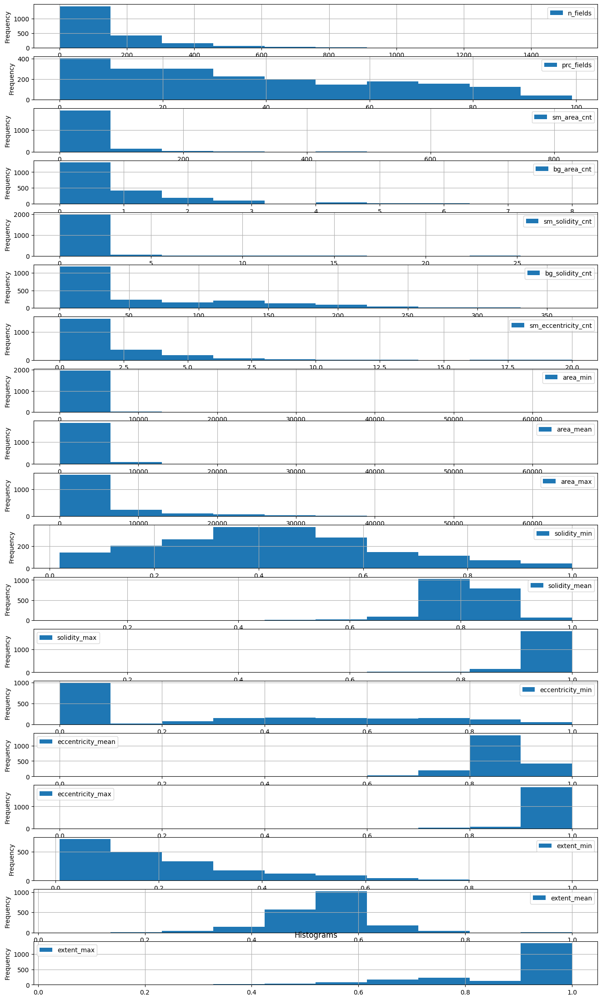

Total number of fields 0.26 M
Total area of fields in ha 49.7 M
Number of patches without fields present 80 (3.83%)
Number of patches with small percentage  (< 10) of fields present 324 (15.49%)
Number of patches with small number (< 40) of fields present 820 (39.22%)
Number of patches with small number or small percentage of fields present combined 855 (40.89%)
Number of patches with small number & small percentage of fields present combined 289 (13.82%)
Number of patches with n_fields (>= 439.24) of fields present 101 (4.83%)
Number of patches with prc_fields (>= 75.0) of fields present 243 (11.62%)
Number of patches with prc_fields (< 25.0) of fields present 880 (42.09%)
Number of patches with sm_area_cnt (>= 133.48) of fields present 85 (4.07%)
Number of patches with bg_area_cnt (>= 3.08) of fields present 79 (3.78%)
Number of patches with sm_solidity_cnt (>= 4.18) of fields present 53 (2.53%)
Number of patches with bg_solidity_cnt (>= 202.81) of fields present 105 (5.02%)
Number o

In [4]:
data = general_eda_main(SENTINEL2_DIR, country,
                     sm_prc_fields=10, sm_num_fields=40)

### Visualizations of the country data

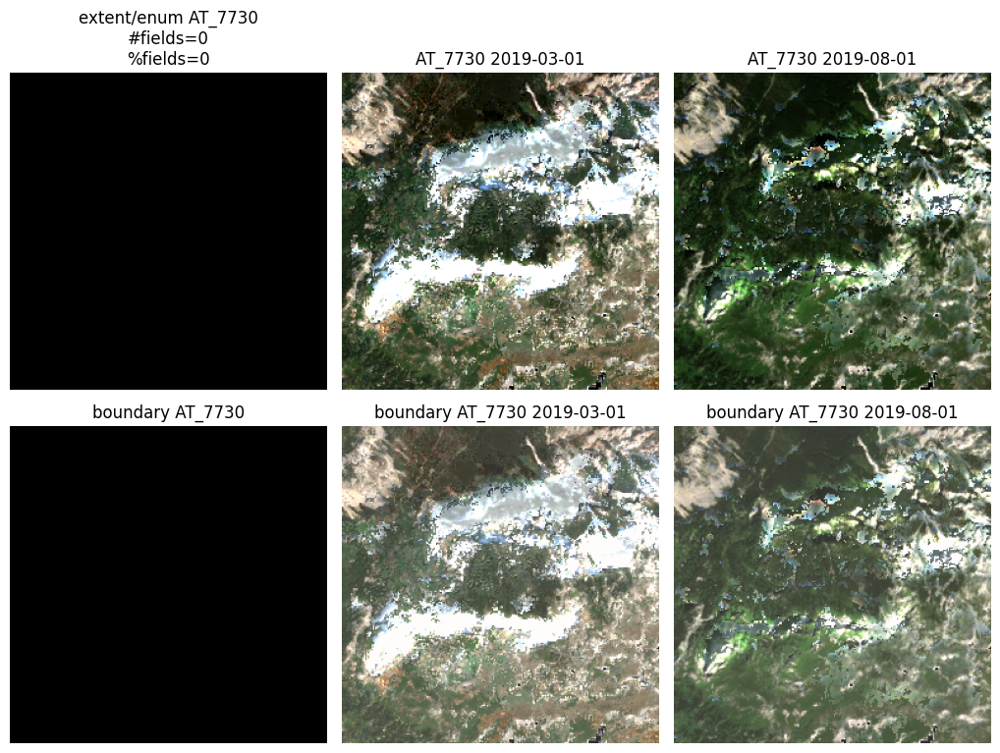

In [9]:
# visualize the data with no fields
visualize_col_data(data, SENTINEL2_DIR, country=country, col='no_field', num_img=2,
                       num_plots=1)

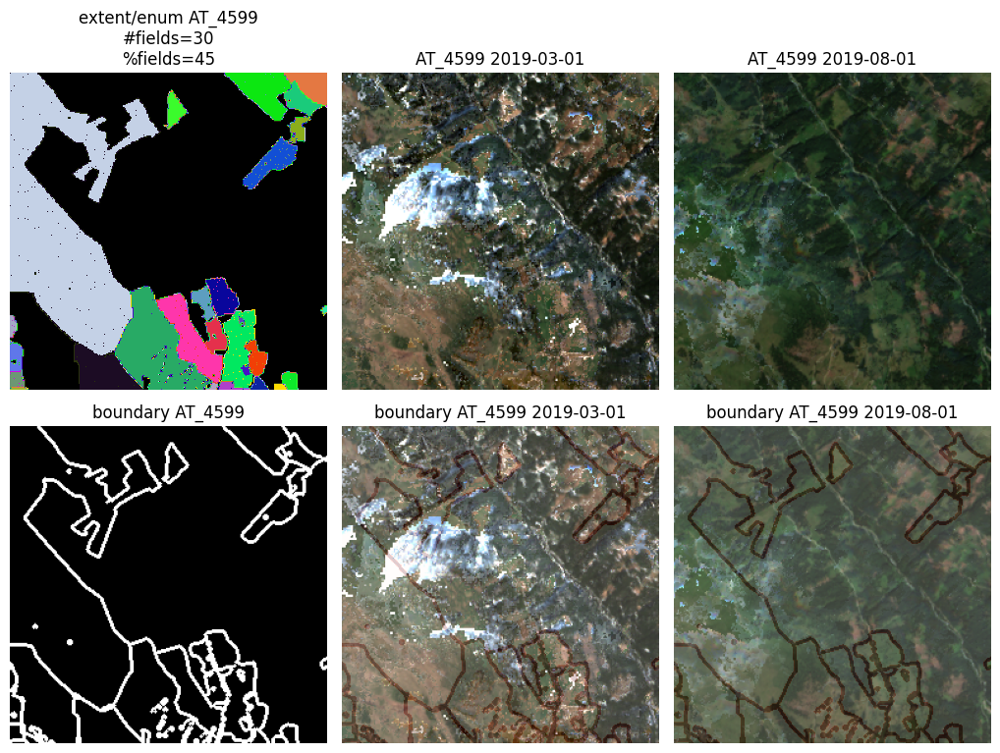

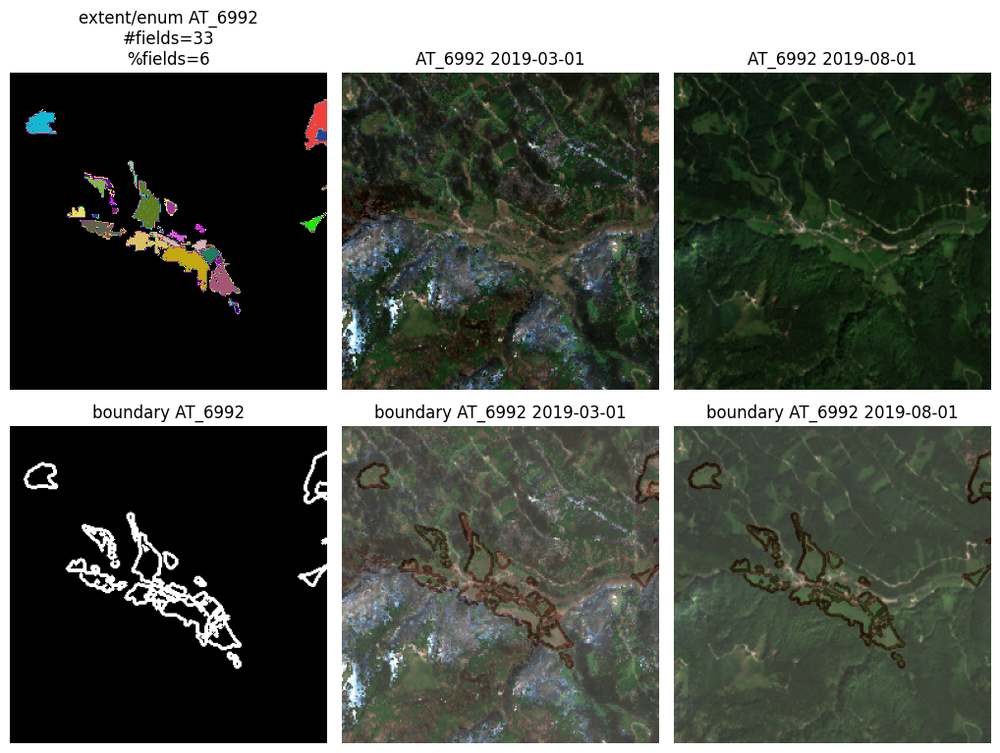

In [12]:
# visualize the data with small number of fields (<40)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='sm_num_fields', num_img=2,
                       num_plots=2)

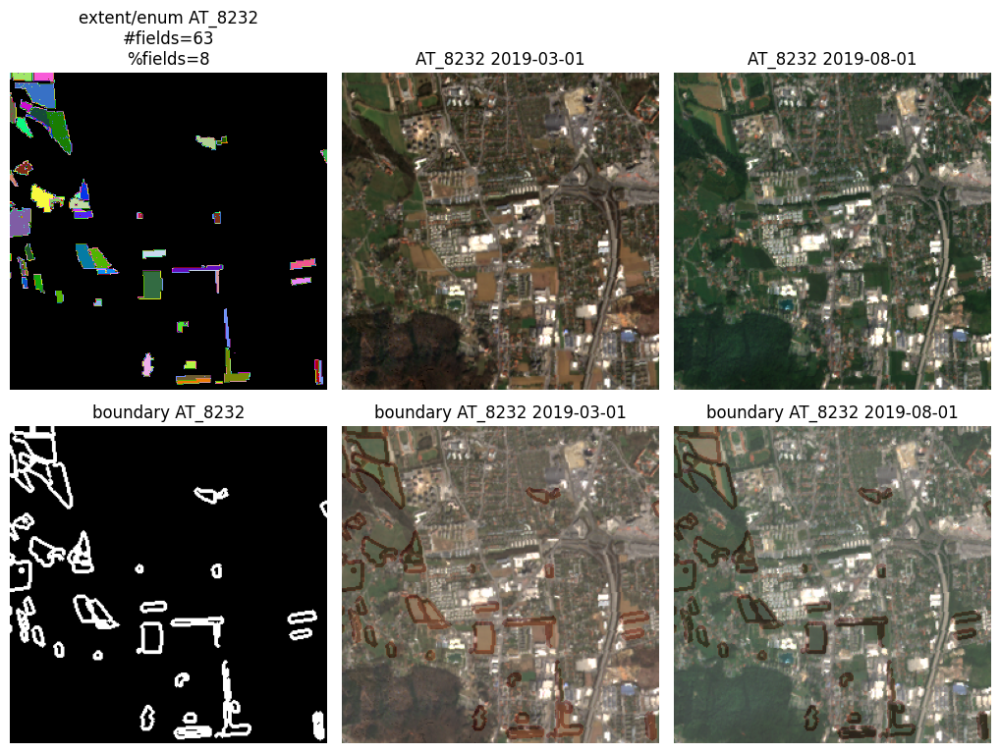

In [15]:
# visualize the data with small % of fields (<10%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='sm_prc_fields', num_img=2,
                       num_plots=1)

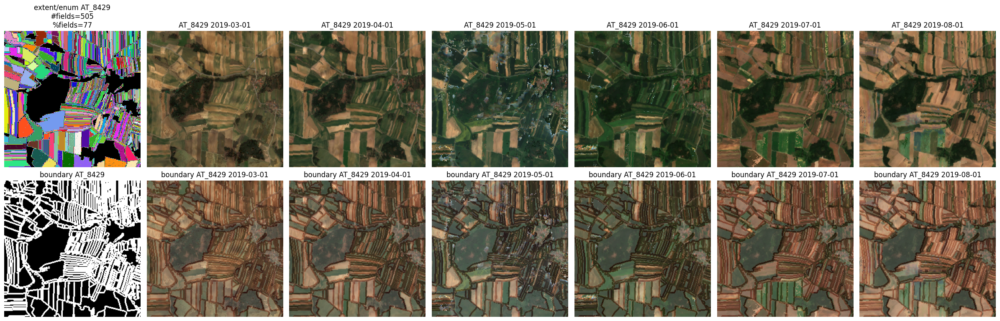

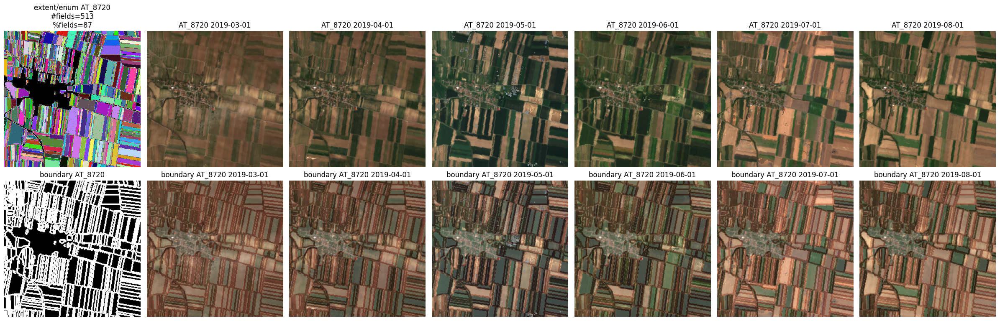

In [20]:
# visualze patches with a lot of fields present
# Number of patches with n_fields (>= 439.24) of fields present 101 (4.83%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='n_fields_gt', num_img=6,
                       num_plots=2)

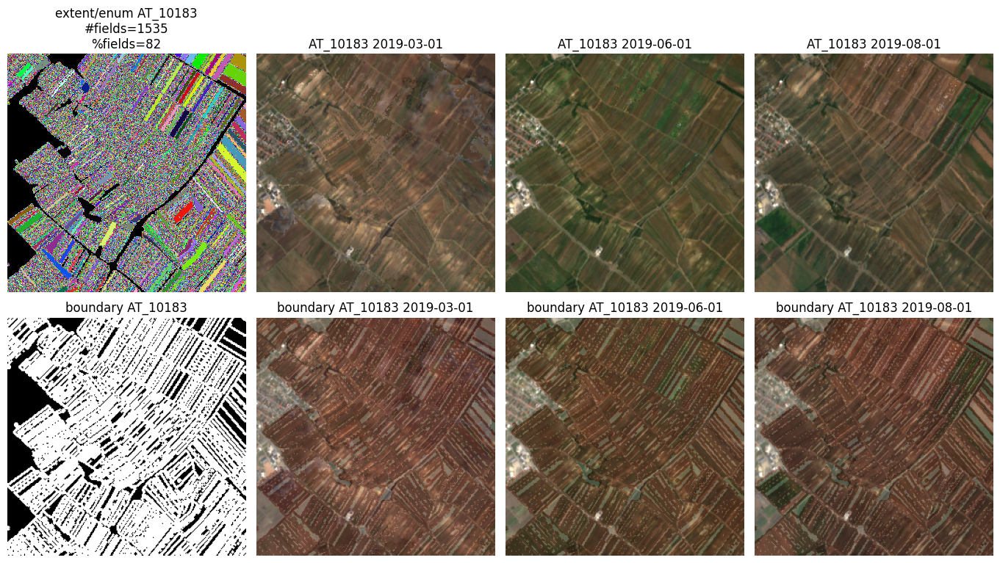

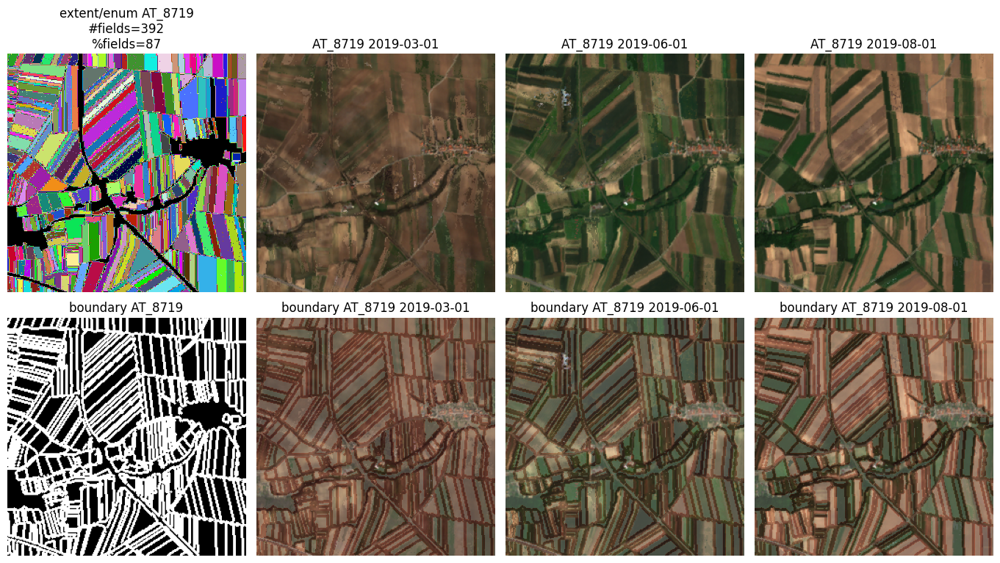

In [23]:
# visualze patches with a lot of % fields present
# Number of patches with prc_fields (>= 75.0) of fields present 243 (11.62%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='prc_fields_gt', num_img=3,
                       num_plots=2)

In [ ]:
# visualze the patches with #field small area > 133
# Number of patches with sm_area_cnt (>= 133.48) of fields present 85 (4.07%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='sm_area_cnt_gt', num_img=2,
                       num_plots=1) # no intresent

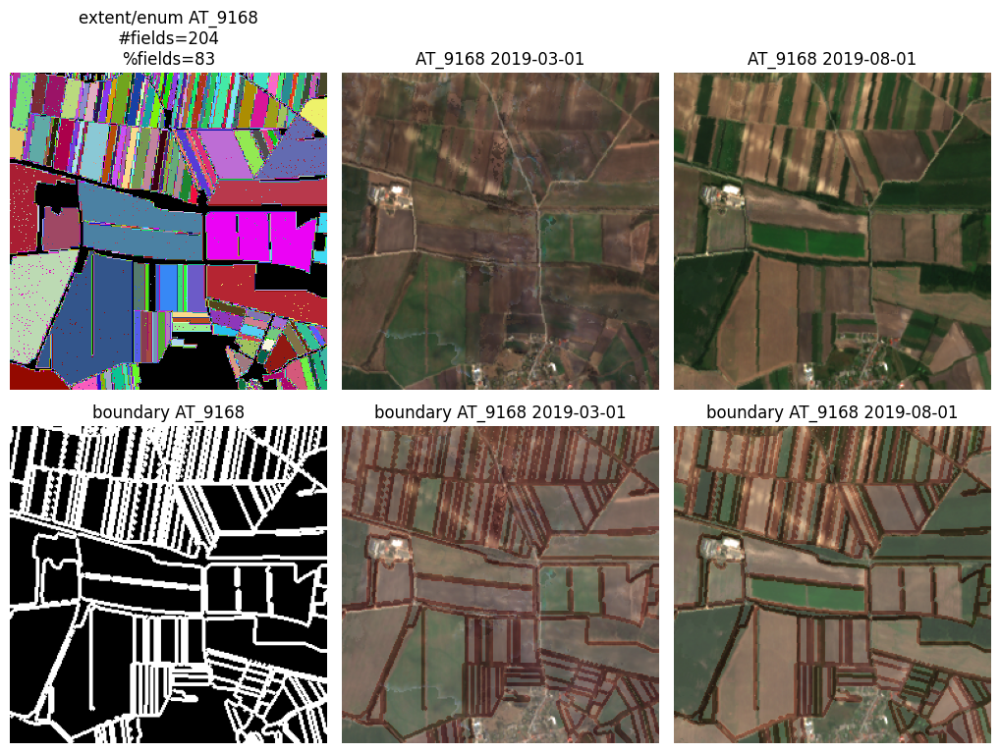

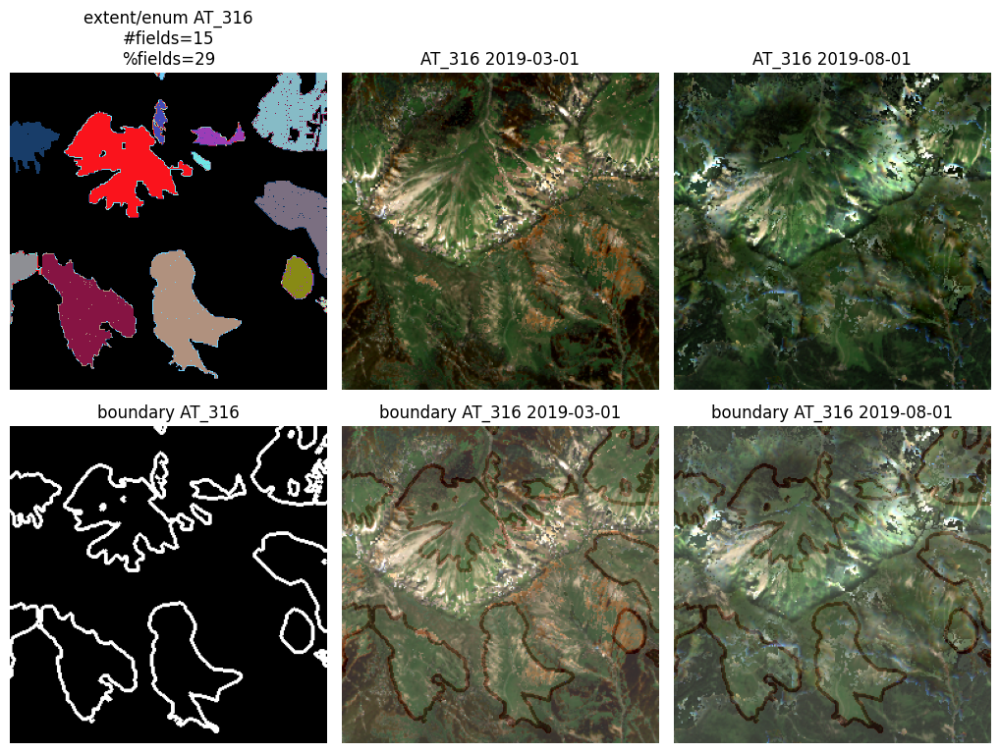

In [29]:
# visualze the patches with the following rool
# Number of patches with bg_area_cnt (>= 3.08) of fields present 79 (3.78%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='bg_area_cnt_gt', num_img=2,
                       num_plots=2)

In [ ]:
# visualze the patches with the following rool
# Number of patches with sm_solidity_cnt (>= 4.18) of fields present 53 (2.53%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='sm_solidity_cnt_gt', num_img=1,
                       num_plots=1) # not much info

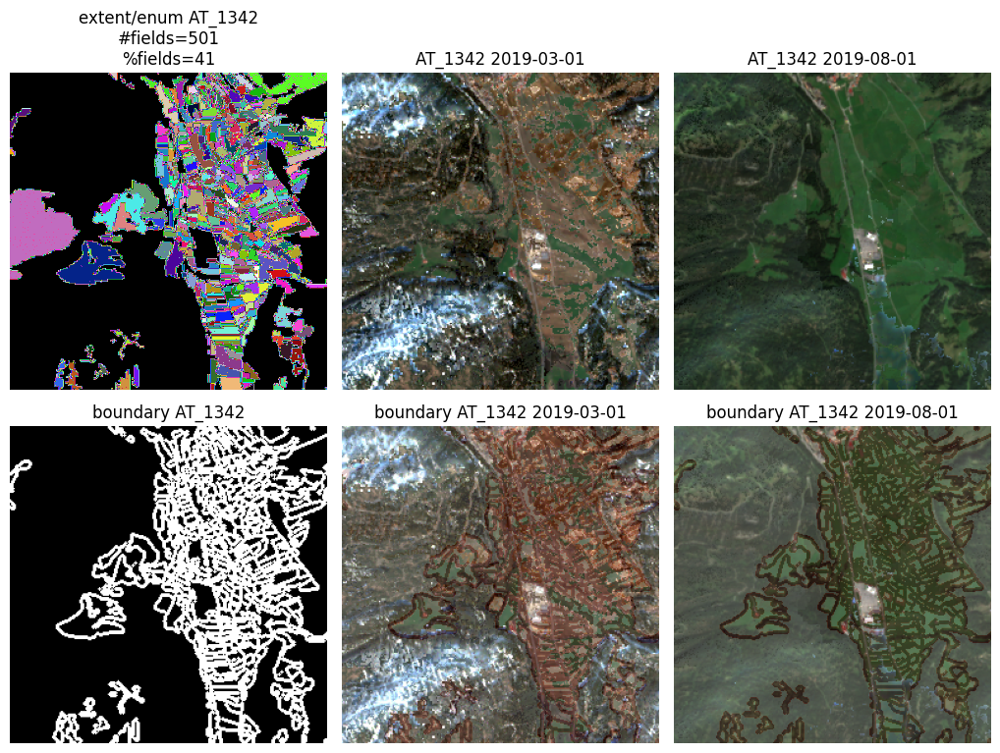

In [36]:
# visualze the patches with the following rool
# Number of patches with bg_solidity_cnt (>= 202.81) of fields present 105 (5.02%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='bg_solidity_cnt_gt', num_img=2,
                       num_plots=1) # no much intersent (rectangular compact fields)

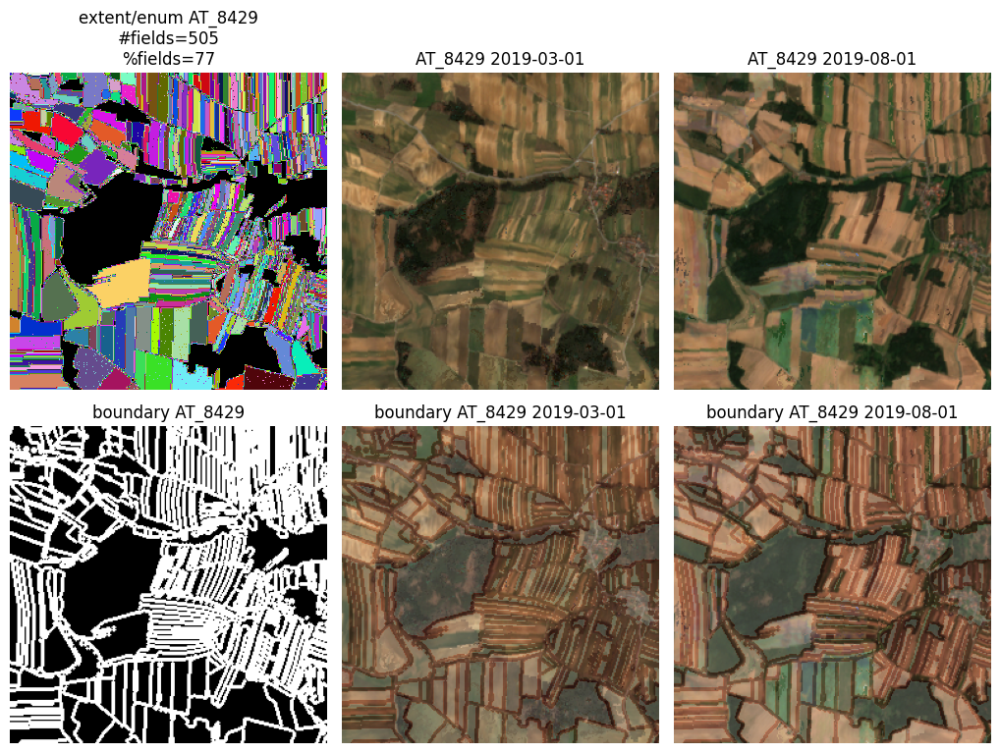

In [34]:
# visualze the patches with the following rool
# Number of patches with sm_eccentricity_cnt (>= 5.41) of fields present 96 (4.59%)
visualize_col_data(data, SENTINEL2_DIR, country=country, col='sm_eccentricity_cnt_gt', num_img=2,
                       num_plots=1)

### Conclusion for the country (AT)

For no fields (town view):

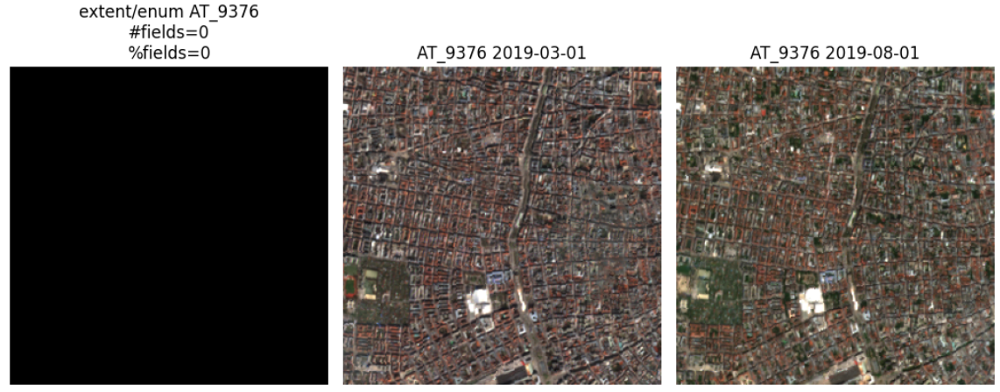

For no fields (montain view):

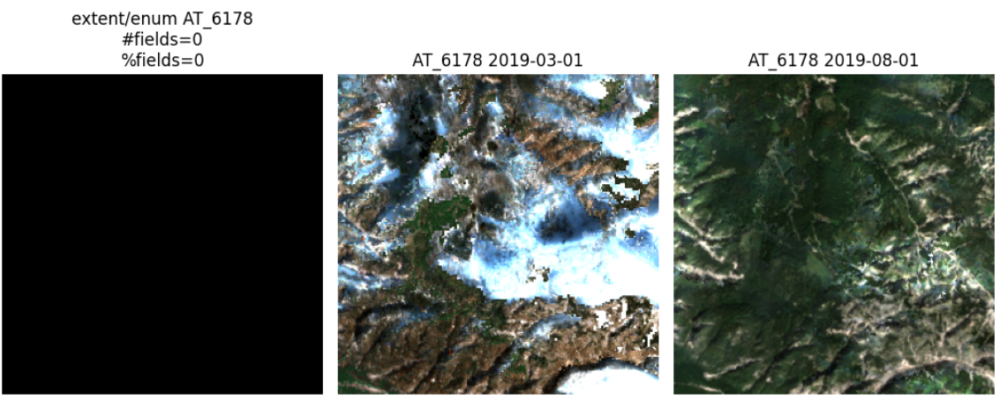


Missing gt fields (num_fields < 40).

Cloud artifacts (prc_fields < 10%).


-> better delete prc_fields < 10% or num_fields < 40 data from training dataset.

March, April (not much of the greenary visible yet):

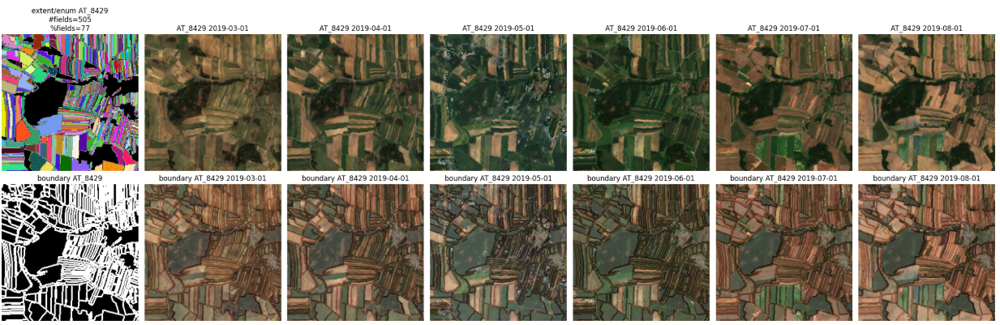

Based on eccentricity visualizations -> no circular fields. But unconventional shapes are present (montains?):
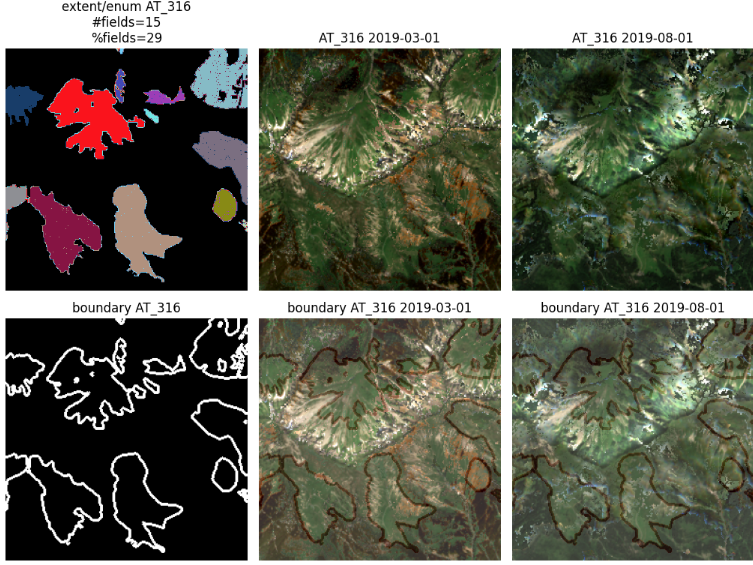

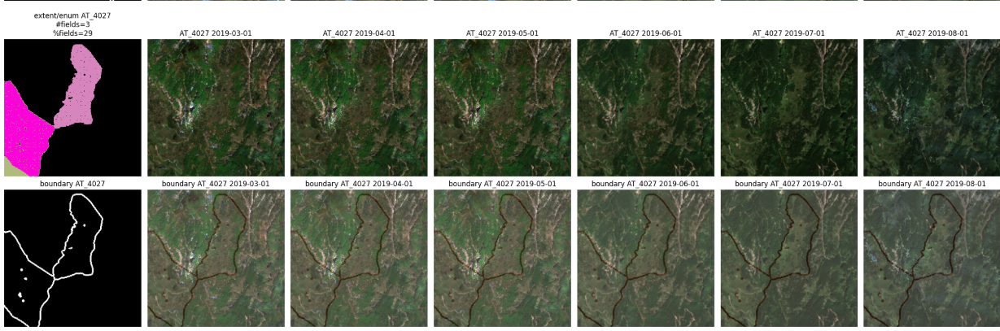

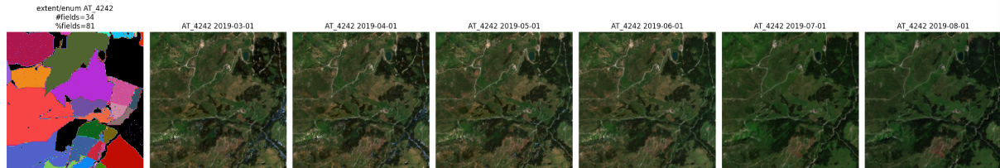

__TO BE DELETED__: (Number of patches without fields present 80 (3.83%)) +
(Number of patches with small number or small percentage of fields present combined 855 (40.89%)) -> ~45% delete for the training data (clouds artifacts, forest or other greenary/ montains, not clear if there shoud be a field a not).